<a href="https://colab.research.google.com/github/RAMI-SALAM/Pyton-for-data-anlytics/blob/main/Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Python Programming for Business Analytics**
---
#**FINAL PROJECT**


> This project involves analyzing a business dataset using Python for data manipulation, visualization, SQL integration, and providing insights to inform business decisions.

---



> The dataset used is "IBM HR Analytics Employee Attrition & Performance" available at www.kaggle.com. The data involves the factors that lead to employee attrition and explore important questions such as ‘show me a breakdown of distance from home by job role and attrition’ or ‘compare average monthly income by education and attrition’. This is a fictional data set created by IBM data scientists. Click the link attached to further explore the dataset https://www.kaggle.com/datasets/pavansubhasht/ibm-hr-analytics-attrition-dataset


---







## LOADING THE DATASET


> By using Kaggle's beta API, we can interact with Datasets to download data via the command line. For doing the same we have to login to the kaggle account and create a new API token, download the json file and upload the same to google colab drive.



### Setting up kaggle

In [1]:
!pip install kaggle --quiet
from google.colab import files
import os

In [4]:
# Kaggle API json file is to be uploaded
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ramisalam1","key":"9148a51506933664ee4dbf5027f9fc2c"}'}

In [5]:
# Moving the uploaded kaggle.json to the right directory
os.makedirs('/root/.kaggle', exist_ok=True)
os.rename('kaggle.json', '/root/.kaggle/kaggle.json')

# Changong permissions to make the API key file accessible
os.chmod('/root/.kaggle/kaggle.json', 600)

### Downloading Unzipping and Loading the dataset

In [6]:
# Step 4: Download the dataset (replace with the appropriate dataset ID)
!kaggle datasets download -d pavansubhasht/ibm-hr-analytics-attrition-dataset

Dataset URL: https://www.kaggle.com/datasets/pavansubhasht/ibm-hr-analytics-attrition-dataset
License(s): DbCL-1.0
  0% 0.00/50.1k [00:00<?, ?B/s]
100% 50.1k/50.1k [00:00<00:00, 59.5MB/s]


In [7]:
# Step 5: Unzip the dataset
!unzip ibm-hr-analytics-attrition-dataset.zip -d /content/ibm_hr

Archive:  ibm-hr-analytics-attrition-dataset.zip
  inflating: /content/ibm_hr/WA_Fn-UseC_-HR-Employee-Attrition.csv  


In [8]:
# Now you can load the dataset (e.g., using pandas)
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sqlalchemy import create_engine, MetaData, Table, Column, Integer, String, Float
data = pd.read_csv('/content/ibm_hr/WA_Fn-UseC_-HR-Employee-Attrition.csv')
data.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


##DATA MANIPULATION

###Inspecting the data

In [9]:
print("Dataset Overview:")
print(data.info())

print("\nFirst 5 Rows of the Dataset:")
print(data.head())

print("\nLast 5 Rows of the Dataset:")
print(data.tail())

print("\nSummary Statistics:")
print(data.describe())

print("\nDataset Summary:")
print(data.describe(include='all'))

Dataset Overview:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLev

#### Findings
>

* The dataset consists of 1470 entries (indexed from 0 to 1469) and 35 columns. The columns have integer (int64) and object data types. So 35 features with 22 categorical and 13 numerical.
* There are no missing values in the dataset since no null entries.
*   The columns have correct data types assigned.
*   On inspecting Minimum , Maximum and Mean every numeric variables are having reasonable values. There was no values that arise any suspision of faulty data.
*   On inspecting Uniaue, Top and Frequency of categorical values, everything was reasonable. The summary of Attrition column The 'top' row indicates that the most frequent value is 'No' appearing 1233 times.









### Cleaning the data

In [19]:
# Drop duplicates (if any)
data = data.drop_duplicates()

### Mathmatical operations & Data Mnipulation

In [11]:
# Define a reusable function to calculate attrition rate
def calculate_attrition_rate(data):
    total_employees = len(data)
    attrition_count = data['Attrition'].value_counts().get('Yes', 0)
    attrition_rate = (attrition_count / total_employees) * 100
    return attrition_rate

attrition_rate = calculate_attrition_rate(data)
print(f"\nAttrition Rate: {attrition_rate:.2f}%")


Attrition Rate: 16.12%


In [20]:
# Group data by department and calculate mean satisfaction levels
department_satisfaction = data.groupby('Department')['JobSatisfaction'].mean().sort_values()
print("\nAverage Job Satisfaction by Department:")
print(department_satisfaction)


Average Job Satisfaction by Department:
Department
Human Resources           2.603175
Research & Development    2.726327
Sales                     2.751121
Name: JobSatisfaction, dtype: float64


### Plotting Graphs

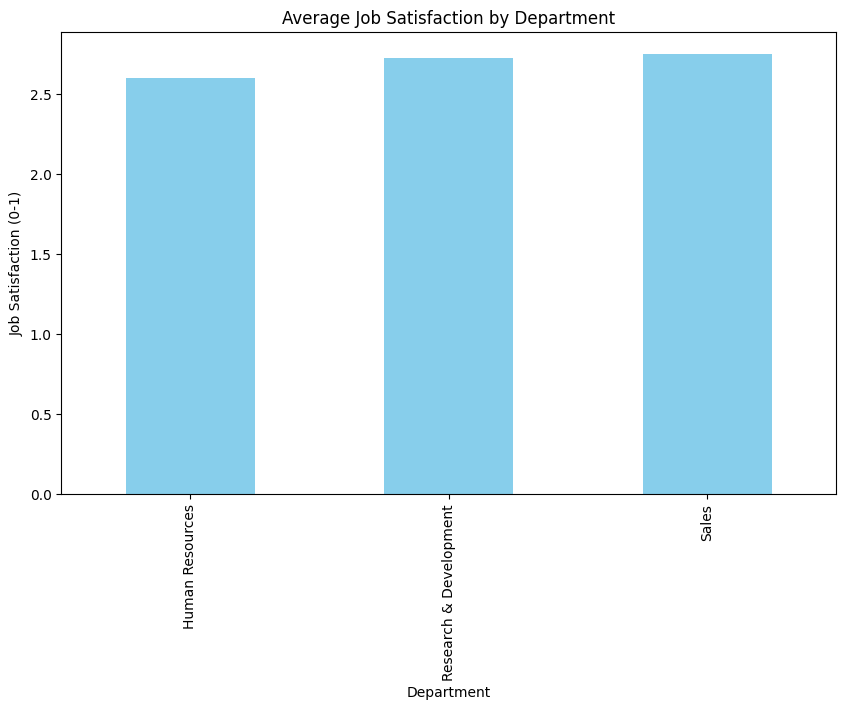

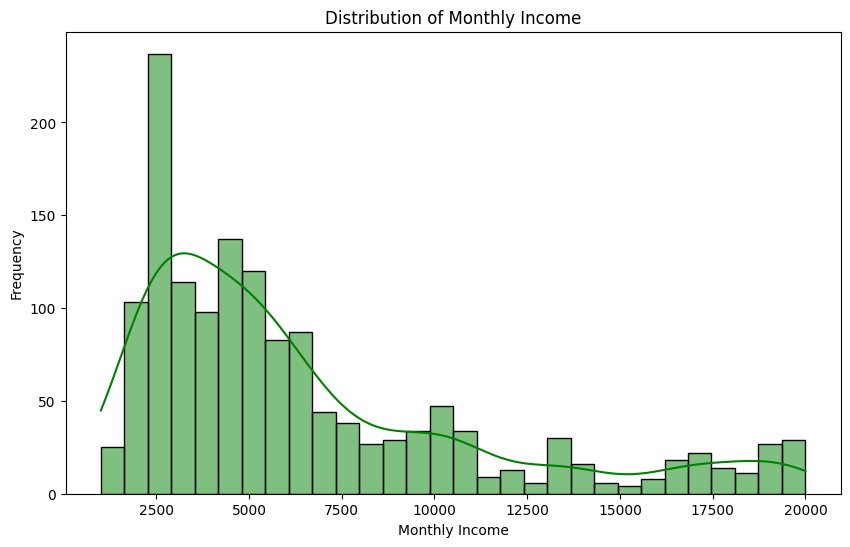

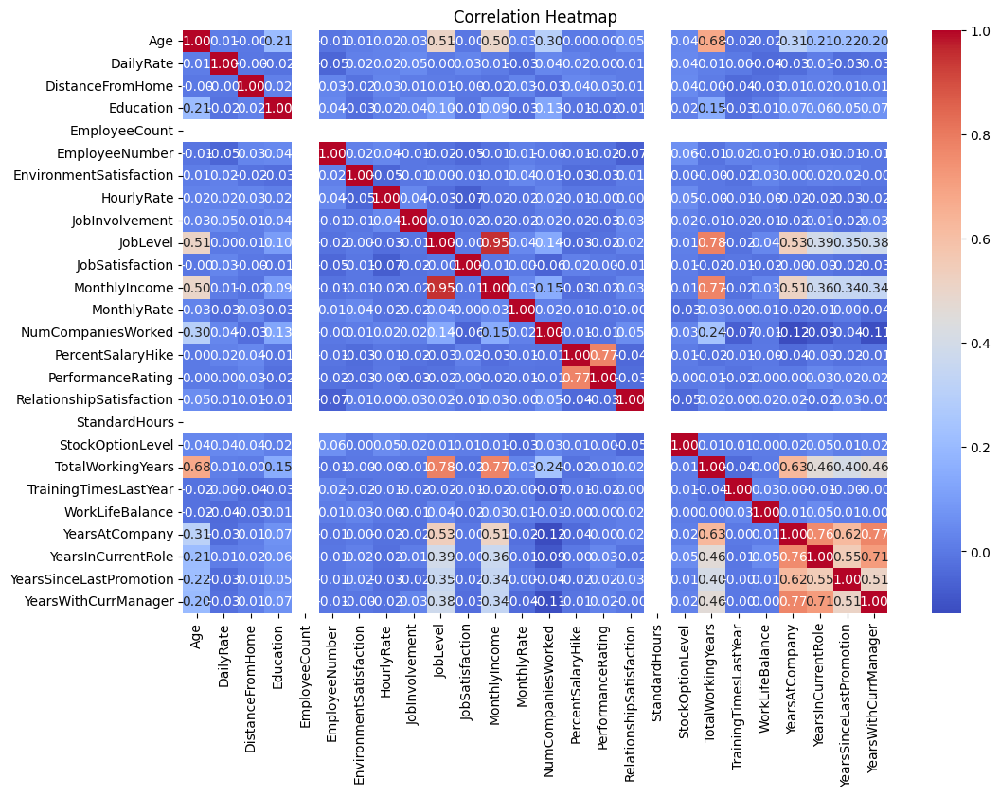

In [14]:
plt.figure(figsize=(10, 6))

# Bar Chart: Average Job Satisfaction by Department
department_satisfaction.plot(kind='bar', color='skyblue')
plt.title('Average Job Satisfaction by Department')
plt.ylabel('Job Satisfaction (0-1)')
plt.xlabel('Department')
plt.show()

# Histogram: Distribution of Monthly Income
plt.figure(figsize=(10, 6))
sns.histplot(data['MonthlyIncome'], bins=30, kde=True, color='green')
plt.title('Distribution of Monthly Income')
plt.xlabel('Monthly Income')
plt.ylabel('Frequency')
plt.show()

# Heatmap: Correlation Between Features
plt.figure(figsize=(12, 8))
# Select only numerical features for correlation calculation
numerical_data = data.select_dtypes(include=['number'])
correlation_matrix = numerical_data.corr()
sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()



Attrition by Department:
               Department  Attrition_Count  Attrition_Percentage
0  Research & Development              133             56.118143
1                   Sales               92             38.818565
2         Human Resources               12              5.063291

Average Monthly Income by Job Role:
                     JobRole  Avg_Monthly_Income
0                    Manager        17181.676471
1          Research Director        16033.550000
2  Healthcare Representative         7528.763359
3     Manufacturing Director         7295.137931
4            Sales Executive         6924.279141
5            Human Resources         4235.750000
6         Research Scientist         3239.972603
7      Laboratory Technician         3237.169884
8       Sales Representative         2626.000000

Impact of Overtime on Attrition:
  OverTime  Attrition_Count
0      Yes              127
1       No              110

Satisfaction Levels by Department:
               Department  Avg_Jo

<ipython-input-15-42aca01c37a8>:115: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Attrition_Percentage', data=result1, palette='viridis')


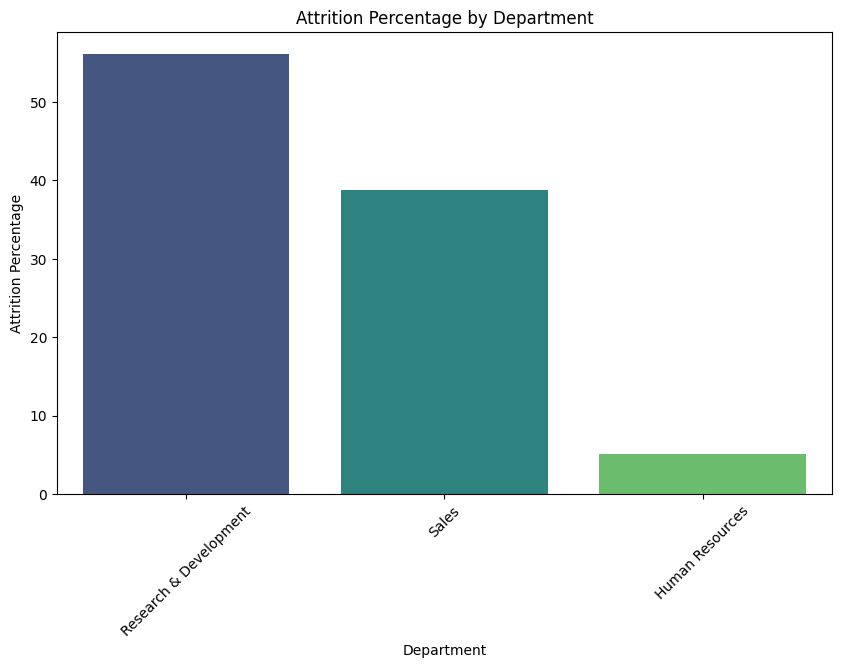

<ipython-input-15-42aca01c37a8>:124: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='JobRole', y='Avg_Monthly_Income', data=result2, palette='coolwarm')


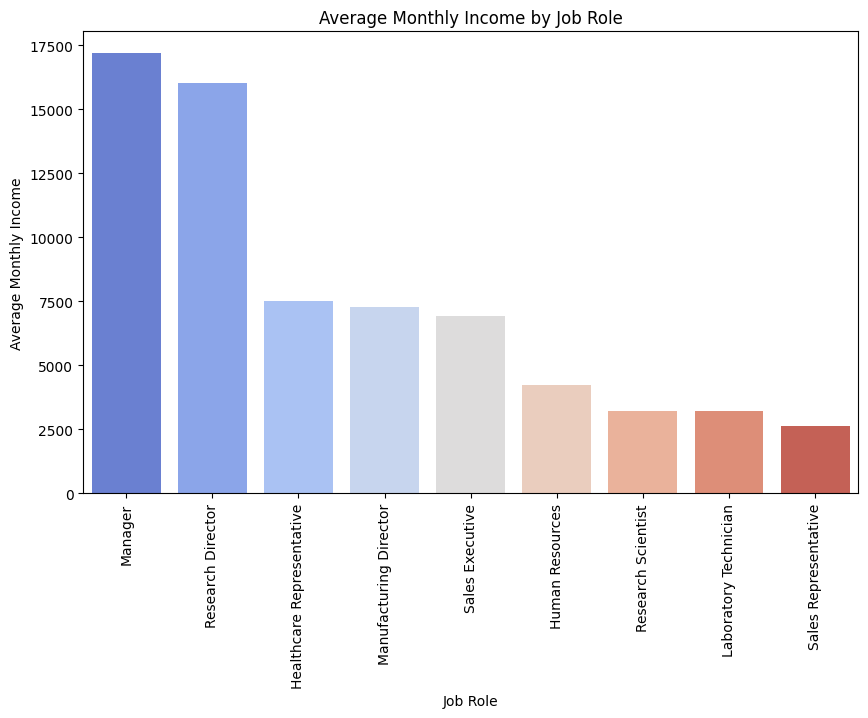

<ipython-input-15-42aca01c37a8>:133: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='OverTime', y='Attrition_Count', data=result3, palette='magma')


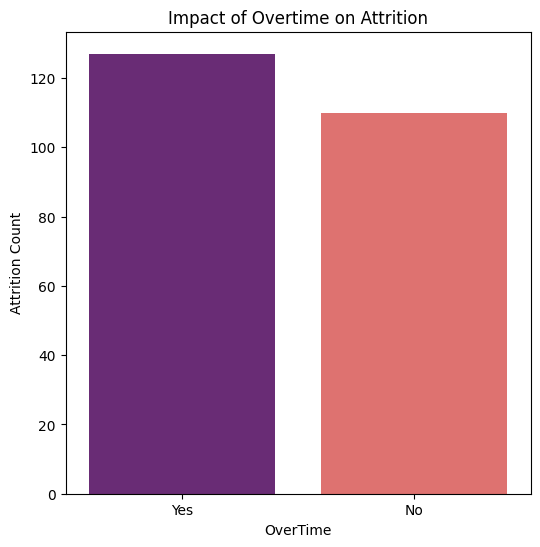

<ipython-input-15-42aca01c37a8>:141: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Department', y='Avg_Job_Satisfaction', data=result4, palette='Blues_d')


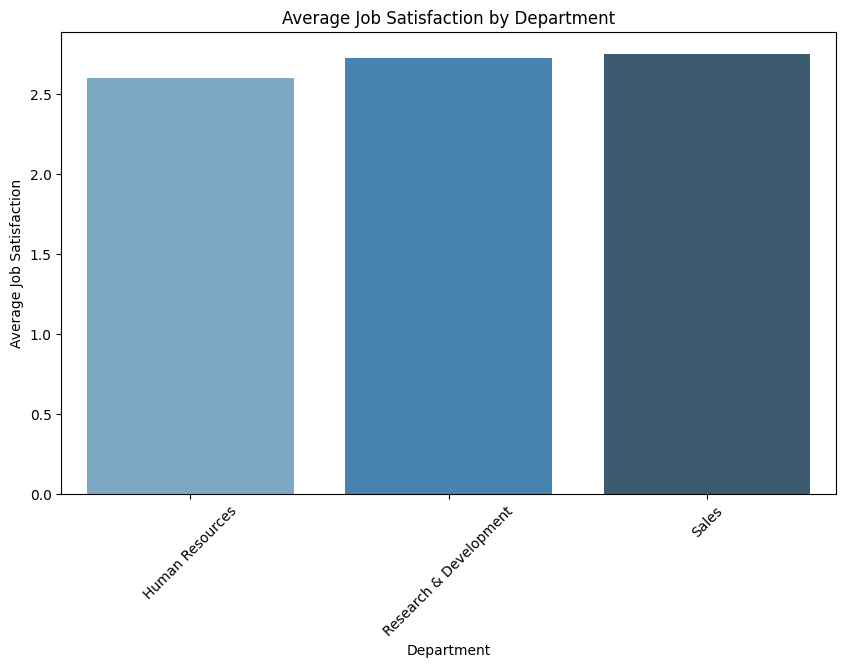

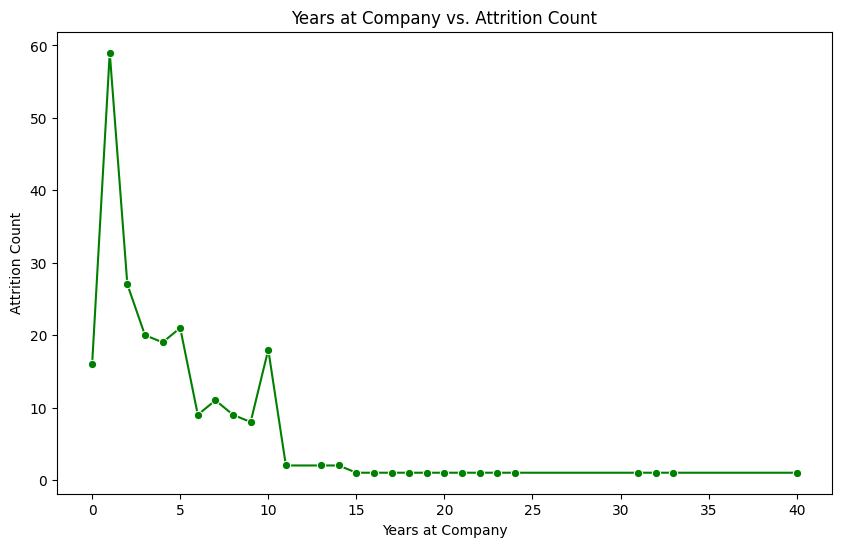

In [15]:
# Step 8: SQL Integration with SQLAlchemy
# Create a SQLite database and store the dataset
engine = create_engine('sqlite:///employee_data.db')
metadata = MetaData()

# Define the table structure
employee_table = Table(
    'employee_data', metadata,
    Column('Age', Integer),
    Column('Attrition', String),
    Column('BusinessTravel', String),
    Column('DailyRate', Integer),
    Column('Department', String),
    Column('DistanceFromHome', Integer),
    Column('Education', Integer),
    Column('EducationField', String),
    Column('EmployeeCount', Integer),
    Column('EmployeeNumber', Integer),
    Column('EnvironmentSatisfaction', Integer),
    Column('Gender', String),
    Column('HourlyRate', Integer),
    Column('JobInvolvement', Integer),
    Column('JobLevel', Integer),
    Column('JobRole', String),
    Column('JobSatisfaction', Integer),
    Column('MaritalStatus', String),
    Column('MonthlyIncome', Float),
    Column('MonthlyRate', Integer),
    Column('NumCompaniesWorked', Integer),
    Column('Over18', String),
    Column('OverTime', String),
    Column('PercentSalaryHike', Integer),
    Column('PerformanceRating', Integer),
    Column('RelationshipSatisfaction', Integer),
    Column('StandardHours', Integer),
    Column('StockOptionLevel', Integer),
    Column('TotalWorkingYears', Integer),
    Column('TrainingTimesLastYear', Integer),
    Column('WorkLifeBalance', Integer),
    Column('YearsAtCompany', Integer),
    Column('YearsInCurrentRole', Integer),
    Column('YearsSinceLastPromotion', Integer),
    Column('YearsWithCurrManager', Integer)
)

# Create the table in the database
metadata.create_all(engine)

# Insert data into the database
data.to_sql('employee_data', engine, if_exists='replace', index=False)

# Query 1: Attrition by Department
query1 = """
SELECT Department,
       COUNT(*) AS Attrition_Count,
       (COUNT(*) * 100.0 / (SELECT COUNT(*) FROM employee_data WHERE Attrition = 'Yes')) AS Attrition_Percentage
FROM employee_data
WHERE Attrition = 'Yes'
GROUP BY Department
ORDER BY Attrition_Percentage DESC
"""
result1 = pd.read_sql(query1, engine)
print("\nAttrition by Department:")
print(result1)

# Query 2: Average Monthly Income by Job Role
query2 = """
SELECT JobRole, AVG(MonthlyIncome) AS Avg_Monthly_Income
FROM employee_data
GROUP BY JobRole
ORDER BY Avg_Monthly_Income DESC
"""
result2 = pd.read_sql(query2, engine)
print("\nAverage Monthly Income by Job Role:")
print(result2)

# Query 3: Impact of Overtime on Attrition
query3 = """
SELECT OverTime, COUNT(*) AS Attrition_Count
FROM employee_data
WHERE Attrition = 'Yes'
GROUP BY OverTime
ORDER BY Attrition_Count DESC
"""
result3 = pd.read_sql(query3, engine)
print("\nImpact of Overtime on Attrition:")
print(result3)

# Query 4: Satisfaction Levels by Department
query4 = """
SELECT Department, AVG(JobSatisfaction) AS Avg_Job_Satisfaction
FROM employee_data
GROUP BY Department
ORDER BY Avg_Job_Satisfaction ASC
"""
result4 = pd.read_sql(query4, engine)
print("\nSatisfaction Levels by Department:")
print(result4)

# Query 5: Years at Company vs. Attrition
query5 = """
SELECT YearsAtCompany, COUNT(*) AS Attrition_Count
FROM employee_data
WHERE Attrition = 'Yes'
GROUP BY YearsAtCompany
ORDER BY YearsAtCompany
"""
result5 = pd.read_sql(query5, engine)
print("\nYears at Company vs. Attrition:")
print(result5)

# Visualizations for Key Insights
# Visualization 1: Attrition by Department
plt.figure(figsize=(10, 6))
sns.barplot(x='Department', y='Attrition_Percentage', data=result1, palette='viridis')
plt.title('Attrition Percentage by Department')
plt.ylabel('Attrition Percentage')
plt.xlabel('Department')
plt.xticks(rotation=45)
plt.show()

# Visualization 2: Average Monthly Income by Job Role
plt.figure(figsize=(10, 6))
sns.barplot(x='JobRole', y='Avg_Monthly_Income', data=result2, palette='coolwarm')
plt.title('Average Monthly Income by Job Role')
plt.ylabel('Average Monthly Income')
plt.xlabel('Job Role')
plt.xticks(rotation=90)
plt.show()

# Visualization 3: Impact of Overtime on Attrition
plt.figure(figsize=(6, 6))
sns.barplot(x='OverTime', y='Attrition_Count', data=result3, palette='magma')
plt.title('Impact of Overtime on Attrition')
plt.ylabel('Attrition Count')
plt.xlabel('OverTime')
plt.show()

# Visualization 4: Satisfaction Levels by Department
plt.figure(figsize=(10, 6))
sns.barplot(x='Department', y='Avg_Job_Satisfaction', data=result4, palette='Blues_d')
plt.title('Average Job Satisfaction by Department')
plt.ylabel('Average Job Satisfaction')
plt.xlabel('Department')
plt.xticks(rotation=45)
plt.show()

# Visualization 5: Years at Company vs. Attrition
plt.figure(figsize=(10, 6))
sns.lineplot(x='YearsAtCompany', y='Attrition_Count', data=result5, marker='o', color='green')
plt.title('Years at Company vs. Attrition Count')
plt.ylabel('Attrition Count')
plt.xlabel('Years at Company')
plt.show()

In [16]:
!pip install ydata-profiling sweetviz > /dev/null 2>&1
import sweetviz as sv
import ydata_profiling as ydp

In [17]:
ydp.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [18]:
report = sv.analyze(data, target_feat="Attrition")
report.show_html()

                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.
